> Training a new concept to Stable Diffusion model using Dreambooth, generating images of the new concept using the trained model, and saving the pipeline to HuggingFace Hub

<br>
<div align="center">
  <a href="https://colab.research.google.com/github/prajwal-suresh13/diffusion/blob/master/03_pintu_dreambooth.ipynb"> <img src=https://colab.research.google.com/assets/colab-badge.svg width=150> </a>
</div> <br>

This is the third post on Stable Diffusion. Check out the previous posts through links below if you haven't read them yet
<br><br>
1. **Part 1** - [Stable diffusion - Introduction](https://prajwal-suresh13.github.io/website/posts/2022-11-22-StableDiffusionIntro/01_stable_diffusion_introduction.html).<br>
2. **Part 2** - [Stable diffusion - Negative Prompt, Image to Image & Textual Inversion](https://prajwal-suresh13.github.io/website/posts/2022-11-22-StableDiffusionVariations/02_stable_diffusion_variations.html)

In previous posts, we learnt about Stable Diffusion and its key components VAE, UNet, Scheduler & CLIPTextModel. We also learnt the variations provided by the model such as Negative Prompt and Image to Image pipeline. We implemented all these and named our pipeline as  ```SDPipeline``` . We also learnt how we can use Textual Inversion to train a new concept to the Stable Diffusion model. 

In this post, we will be covering Dreambooth which is similar to Textual Inversion, train a new concept using it and push our model to HuggingFace Hub, from where anyone can use our fine-tuned model. This post is based on the HuggingFace Notebook found [here](https://github.com/huggingface/notebooks/blob/main/diffusers/sd_dreambooth_training.ipynb). So let's get started

# What is Dreambooth?

Stable Diffusion results are amazing. But what if you want to generate images of subjects that are personal to you. Can it render images of your cute pet dog having fun at the beach?  What about you being the main character of superhero movie saving the World?. Yes, you absolutely can personalize the Stable Diffusion model using Dreambooth 

<figure align = "center">
    <figure>
    <img src="https://tryolabs.com/assets/blog/2022-10-25-the-guide-to-fine-tuning-stable-diffusion-with-your-own-images/stable-diffusion21-d3f64be213.jpg" width="380" height="280"style="float:right">
        <figcaption><a href="https://tryolabs.com/blog/2022/10/25/the-guide-to-fine-tuning-stable-diffusion-with-your-own-images">Credits</a></figcaption>
    </figure>
    <figure>
<img src="02.png" width="280" height="280" style="float:left">
         </figure>
</figure>

Dreambooth is an approach to teach a new concept by fine-tuning a pretrained text-to-image model such that it binds a unique token with the new concept of images. If you are aware of fine-tuning vision models, you might be thinking at this point that it will take hundreds of images and hours of training to fine-tune Stable Diffusion model, but to our surprise only a minimum of 5 images of the new subject is required!

The image on the right above is generated from the model which I fine-tuned for around 30 minutes on Tesla T4 GPU and 16GB RAM with just 6 images of my pet dog. Amazing isn't it!

<head> <style>
      .parent {
        position: relative;
        top: 0;
        left: 0;
      }
      .image1 {
        position: relative;
        top: 0;
        left: 0;
        border: 1px solid #000000;
      }
      .image2 {
        position: absolute;
        top: 30px;
        left: 30px;
        border: 1px solid #000000;
      }
    </style></head>

<figure align = "center" class="parent">
   
<img class="image1" src="https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcQrC5Tpk9HcrkzqNa9TnHv5fkwvD8XOqjjAmv0mFMbo&s" width="800" height="450" >
<img class="image2" src="https://dreambooth.github.io/DreamBooth_files/system.png" width="700">
    <figcaption align = "center">
        <h4>Fig 1: Dreambooth approach <a href="https://dreambooth.github.io/">(Image Credit)</a></h4>
</figcaption>
    
</figure>


Dreambooth approach of fine-tuning the text-to image diffusion model is as follows:<br>
1. We pair the input images of our interested subject and text prompt containing a unique identifier and fine tune the model. (Example - for unique identifier you can use a token which is less frequently used such as sks.So the prompt will be "A photo of sks dog")<br>
2. We also pass the class of the subject as a prompt while fine-tuning the model and apply class-specific prior preservation loss (Example - "A photo of a dog") <br>

Prior Preservation doesn't seem to make huge difference except when trained on faces. So prior preservation is not used while training in this post. Checkout this amazing detailed [article](https://wandb.ai/psuraj/dreambooth/reports/Training-Stable-Diffusion-with-Dreambooth--VmlldzoyNzk0NDc3) in which they have experimented training dreambooth with different settings. You can follow the HuggingFace [notebook](https://github.com/huggingface/notebooks/blob/main/diffusers/sd_dreambooth_training.ipynb) in which they have implemented prior preservation

Let's install the required libraries and load the ```CompVis/stable-diffusion-v1-4``` models in the next section

# Getting started

At first, we will be connecting to Google Drive from Google Colab. This allows us to read images saved in Drive for training model and also save the trained model to the Drive

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


We will be downloading the required libraries as we did in previous posts. We will be installing and importing an additional library named ```bitsandbytes```. It provides an 8-bit optimizer which saves memory and increases speed while training. For more details checkout this [repo](https://github.com/TimDettmers/bitsandbytes)

We will also be using ```accelerate``` library which helps in distributed training, gradient accumulation and many more. 

In [1]:
#| output: false
!pip install -Uq accelerate transformers diffusers ftfy

     |████████████████████████████████| 175 kB 13.1 MB/s 
     |████████████████████████████████| 5.5 MB 68.6 MB/s 
     |████████████████████████████████| 453 kB 59.3 MB/s 
     |████████████████████████████████| 53 kB 2.0 MB/s 
     |████████████████████████████████| 182 kB 80.5 MB/s 
     |████████████████████████████████| 7.6 MB 80.5 MB/s 


In [2]:
#| output: false
!pip install -qq bitsandbytes

     |████████████████████████████████| 62.5 MB 73.3 MB/s 


We can authenticate our notebook to Huggingface services using the commands below. Since we will be pushing our model to HuggingFace Hub later, we will need write permissions. So you need to create an Access Token with write permission and use it to authenticate

In [3]:
from huggingface_hub import notebook_login
notebook_login()

Token is valid.
Your token has been saved in your configured git credential helpers (store).
Your token has been saved to /root/.huggingface/token
Login successful


In [4]:
#| code-fold: true
from PIL import Image
import numpy as np
from tqdm.auto import tqdm
from pathlib import Path
import math

import torch
import torch.nn.functional as F
from torch.utils.data import Dataset
from torchvision import transforms as tfms

from diffusers import AutoencoderKL, DDPMScheduler, PNDMScheduler, StableDiffusionPipeline, UNet2DConditionModel
from diffusers.optimization import get_scheduler
from diffusers.pipelines.stable_diffusion import StableDiffusionSafetyChecker

from accelerate import Accelerator
from accelerate.logging import get_logger
from accelerate.utils import set_seed

from transformers import CLIPFeatureExtractor, CLIPTextModel, CLIPTokenizer

import bitsandbytes as bnb

In [5]:
def image_grid(imgs, rows, cols):
    w,h = imgs[0].size
    grid = Image.new("RGB", size=(cols*w, rows*h))
    for i, img in enumerate(imgs):grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

Next, we will initialize the core components of the Stable Diffusion model with the weights of ```CompVis/stable-diffusion-v1-4``` repo

In [ ]:
model_path="CompVis/stable-diffusion-v1-4"

In [ ]:
text_encoder = CLIPTextModel.from_pretrained(model_path, subfolder="text_encoder")
vae          = AutoencoderKL.from_pretrained(model_path, subfolder="vae")
unet         = UNet2DConditionModel.from_pretrained(model_path, subfolder="unet")
tokenizer    = CLIPTokenizer.from_pretrained(model_path, subfolder="tokenizer")

Downloading:   0%|          | 0.00/592 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/492M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/335M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/522 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/743 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/525k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/472 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/806 [00:00<?, ?B/s]

# Data

We need to provide the images of our subject and the prompt with the unique token to fine-tune model. So let's create a dataset which takes images and prompts as input. The dataset needs to convert the images into tensor which is done using PyTorch's transforms. It also should return input_ids for the prompt which is provided by the Tokenizer. Both pixel values and prompt ids are returned as dictionary

In [ ]:
class DreamBoothDataset(Dataset):
    def __init__(self, images_path, prompts , tokenizer, size =512, center_crop=False):
        self.size, self.center_crop = size, center_crop
        self.tokenizer = tokenizer
        self.images_path = Path(images_path)
        if not self.images_path.exists():
            raise ValueError("Images path doesn't exist")

        self.images = list(Path(images_path).iterdir())
        self.num_of_images = len(self.images)
        self.prompts = prompts 

        self.image_transforms = tfms.Compose([
            tfms.Resize(size, interpolation = tfms.InterpolationMode.BILINEAR),
            tfms.CenterCrop(size) if center_crop else tfms.RandomCrop(size),
            tfms.ToTensor(),
            tfms.Normalize([0.5],[0.5])
        ])  
        
            
    def __len__(self):
        return self.num_of_images    

    def __getitem__(self, index):
        example = {}
        image = Image.open(self.images[index%self.num_of_images]).convert("RGB")   
        example["images"] = self.image_transforms(image)  
        example["prompt_ids"] = self.tokenizer(self.prompts, padding="do_not_pad", truncation=True, 
                                               max_length=self.tokenizer.model_max_length).input_ids 
        
        return example          

Dataloader helps us to sample minibatches from our dataset. Since our dataset returns dictionary, we have to tell the Dataloader how it can combine and return minibatches of pixelvalues and prompt_ids. 

In [ ]:
def collate_fn(examples):
    pixels    = [example["images"] for example in examples]
    input_ids = [example["prompt_ids"] for example in examples]
    
    pixels = torch.stack(pixels).to(memory_format=torch.contiguous_format).float()
    input_ids = tokenizer.pad({"input_ids":input_ids}, padding=True, return_tensors="pt").input_ids

    batch = {
        "input_ids":input_ids,
        "pixel_values":pixels
    }

    return batch

In [ ]:
train_dataset = DreamBoothDataset(
        images_path = "/content/gdrive/My Drive/pintu",
        prompts = "a photo of a sks dog",
        tokenizer = tokenizer,
        size=512,
        center_crop=True
    )

train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size= 1, shuffle=True, collate_fn=collate_fn)

Now let's view the our data. Below are the 6 images of my pet Pintu which are used for training

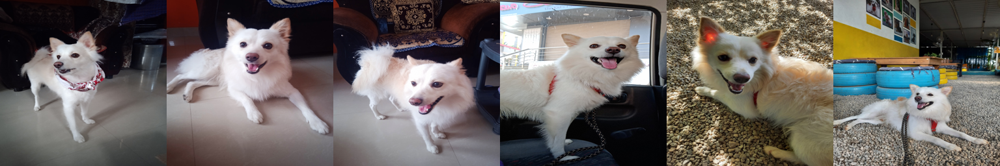

In [ ]:
images =[Image.open(train_dataset.images[i]).resize((256,256)).convert("RGB") for i in range(len(train_dataset))]
image_grid(images, rows=1, cols=len(train_dataset))

<figcaption align = "center">
        <h4>Fig 2: Images used to train Dreambooth model</h4>
</figcaption>

# Training

In [ ]:
learning_rate=5e-06
max_train_steps =500
train_batch_size=1
gradient_accumulation_steps=2
use_8bit_adam=True
output_dir = "/content/gdrive/My Drive/pintu_dreambooth"

In [ ]:
torch_device = "cuda" if torch.cuda.is_available() else "cpu"

The function ```dreambooth_trainer```  fine-tunes the Stable Diffusion model. We fine-tune the model for 500 steps at a learning rate of 5e-06. The ```pixel_values``` of the images from the dataloader are passed to VAE's encoder to generate latents. The ```prompt_ids``` are passed to the text_encoder to generate embeddings. Random noise is added at each step and the loss is calculated. The loss is then backpropogated and the weights of the model are updated. After the training is completed, all the components of the model are saved to the ```output_dir``` path which in our case gets saved to Google Drive

In [ ]:
def dreambooth_trainer(data, text_encoder, vae, unet):

    accelerator=Accelerator(gradient_accumulation_steps=gradient_accumulation_steps)
    set_seed(90000)
    unet.enable_gradient_checkpointing()

    if use_8bit_adam:
        optimizer_class = bnb.optim.AdamW8bit
    else:
        optimizer_class = torch.optim.AdamW

    optimizer = optimizer_class(unet.parameters(), lr=learning_rate)

    noise_scheduler = DDPMScheduler(beta_start= 0.00085, beta_end = 0.012, beta_schedule="scaled_linear",
                                    num_train_timesteps=1000)
    
    
    unet, optimizer, train_dataloader = accelerator.prepare(unet, optimizer, data)

    text_encoder.to(torch_device)
    vae.to(torch_device)


    num_update_steps_per_epoch = math.ceil(len(train_dataloader)/gradient_accumulation_steps)
    num_train_epochs = math.ceil(max_train_steps/num_update_steps_per_epoch)
    total_batch_size = train_batch_size *accelerator.num_processes * gradient_accumulation_steps

    progress_bar = tqdm(range(max_train_steps), disable=not accelerator.is_local_main_process)
    progress_bar.set_description("Steps")
    global_step = 0

    for epoch in range(num_train_epochs):
        unet.train()
        for step, batch in enumerate(train_dataloader):
            with accelerator.accumulate(unet):
                with torch.no_grad():
                    latents = vae.encode(batch["pixel_values"]).latent_dist.sample()
                    latents*=0.18215
                
                
                noise = torch.randn(latents.shape).to(latents.device)
                bsz = latents.shape[0]
                timesteps = torch.randint(0, noise_scheduler.config.num_train_timesteps,(bsz,), device=latents.device).long()
                noisy_latents = noise_scheduler.add_noise(latents, noise, timesteps)

                with torch.no_grad():
                    encoder_hidden_states = text_encoder(batch["input_ids"])[0]

                noise_pred = unet(noisy_latents, timesteps, encoder_hidden_states).sample

                loss = F.mse_loss(noise_pred, noise, reduction="none").mean([1,2,3]).mean()

                accelerator.backward(loss)
                optimizer.step()
                optimizer.zero_grad()
            
            if accelerator.sync_gradients:
                progress_bar.update(1)
                global_step+=1


            logs = {"loss":loss.detach().item()}
            progress_bar.set_postfix(**logs)

            if global_step>=max_train_steps:break

        accelerator.wait_for_everyone()

    if accelerator.is_main_process:
        pipeline=StableDiffusionPipeline(
            text_encoder=text_encoder, vae=vae, unet=unet, 
            tokenizer=tokenizer,
            scheduler = PNDMScheduler(
                beta_start=0.00085, beta_end=0.012, beta_schedule="scaled_linear", skip_prk_steps=True
            ),
            safety_checker=StableDiffusionSafetyChecker.from_pretrained("CompVis/stable-diffusion-safety-checker"),
            feature_extractor=CLIPFeatureExtractor.from_pretrained("openai/clip-vit-base-patch32"))
        pipeline.save_pretrained(output_dir)

In [ ]:
#| output: false
import accelerate
accelerate.notebook_launcher(dreambooth_trainer, args=(train_dataloader,text_encoder, vae, unet), num_processes = 1)

Launching training on one GPU.


  0%|          | 0/500 [00:00<?, ?it/s]

Downloading:   0%|          | 0.00/4.55k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/316 [00:00<?, ?B/s]

/usr/local/lib/python3.7/dist-packages/diffusers/utils/deprecation_utils.py:35: FutureWarning: The configuration file of this scheduler: PNDMScheduler {
  "_class_name": "PNDMScheduler",
  "_diffusers_version": "0.9.0",
  "beta_end": 0.012,
  "beta_schedule": "scaled_linear",
  "beta_start": 0.00085,
  "num_train_timesteps": 1000,
  "set_alpha_to_one": false,
  "skip_prk_steps": true,
  "steps_offset": 0,
  "trained_betas": null
}
 is outdated. `steps_offset` should be set to 1 instead of 0. Please make sure to update the config accordingly as leaving `steps_offset` might led to incorrect results in future versions. If you have downloaded this checkpoint from the Hugging Face Hub, it would be very nice if you could open a Pull request for the `scheduler/scheduler_config.json` file
  warnings.warn(warning + message, FutureWarning)


# Results

Now we can load the model from the saved directory and use it for inference.  To get high quality images, you can use prompts from [Lexica](https://lexica.art/) and replace with your unique identifier. 

In [ ]:
output_dir = "/content/gdrive/My Drive/pintu_dreambooth"
torch_device = "cuda" if torch.cuda.is_available() else "cpu"

pipe = StableDiffusionPipeline.from_pretrained(
        output_dir,
        torch_dtype=torch.float16,
    ).to(torch_device)

Below are some of the astonishing results generated by our fine-tuned model!

  0%|          | 0/76 [00:00<?, ?it/s]

  0%|          | 0/76 [00:00<?, ?it/s]

  0%|          | 0/76 [00:00<?, ?it/s]

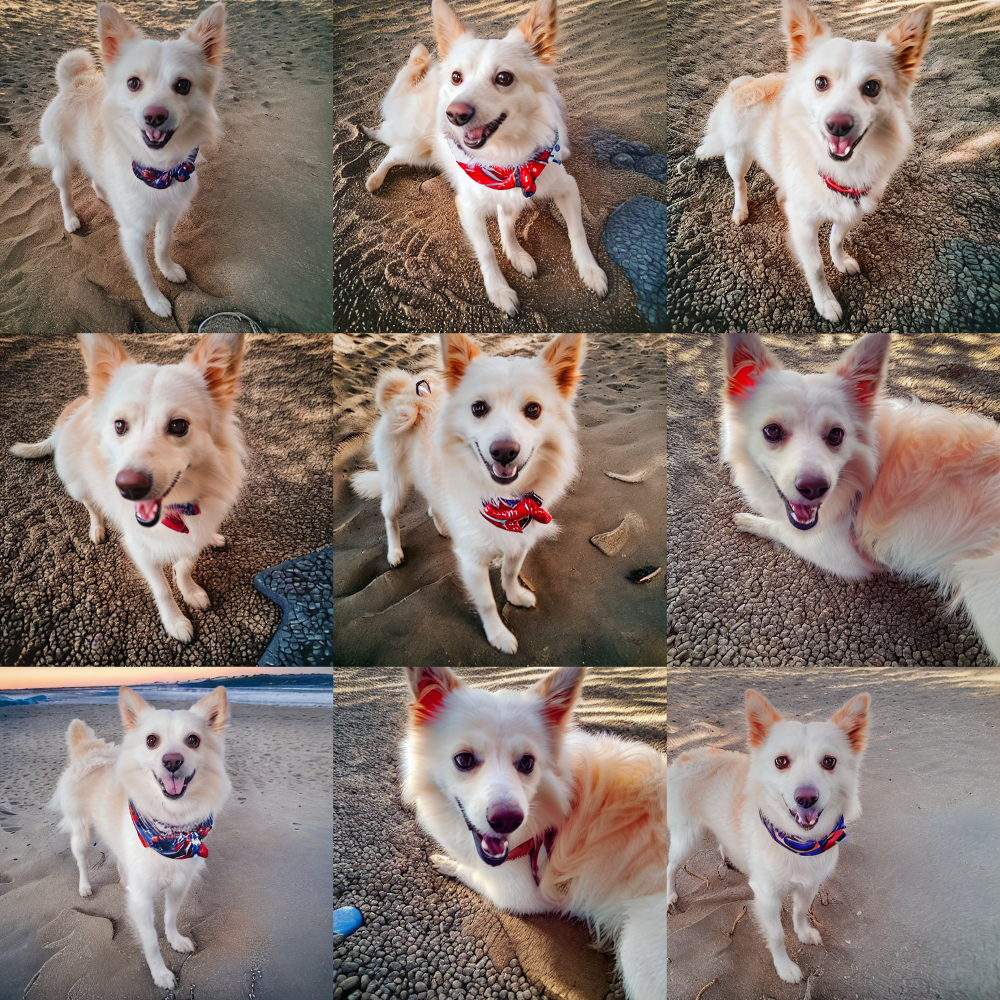

In [ ]:
#| code-fold: true
prompt = "a beautiful portrait of a cute sks dog, beautiful detailed eyes, golden hour, standing on a beach, outdoors, professional award winning portrait photography, Zeiss 150mm f/ 2.8 Hasselblad" 

num_samples = 3 
num_rows = 3 

all_images = [] 
for _ in range(num_rows):
    images = pipe([prompt] * num_samples, num_inference_steps=75, guidance_scale=7.5, seed = 'random').images
    all_images.extend(images)

grid = image_grid(all_images, num_samples, num_rows)
grid 

<figcaption align = "center">
        <h4>Fig 3: A beautiful portrait of a cute sks dog, beautiful detailed eyes, golden hour, standing on a beach, outdoors, professional award winning portrait photography, Zeiss 150mm f/ 2.8 Hasselblad" 
</h4>
</figcaption>

  0%|          | 0/76 [00:00<?, ?it/s]

  0%|          | 0/76 [00:00<?, ?it/s]

  0%|          | 0/76 [00:00<?, ?it/s]

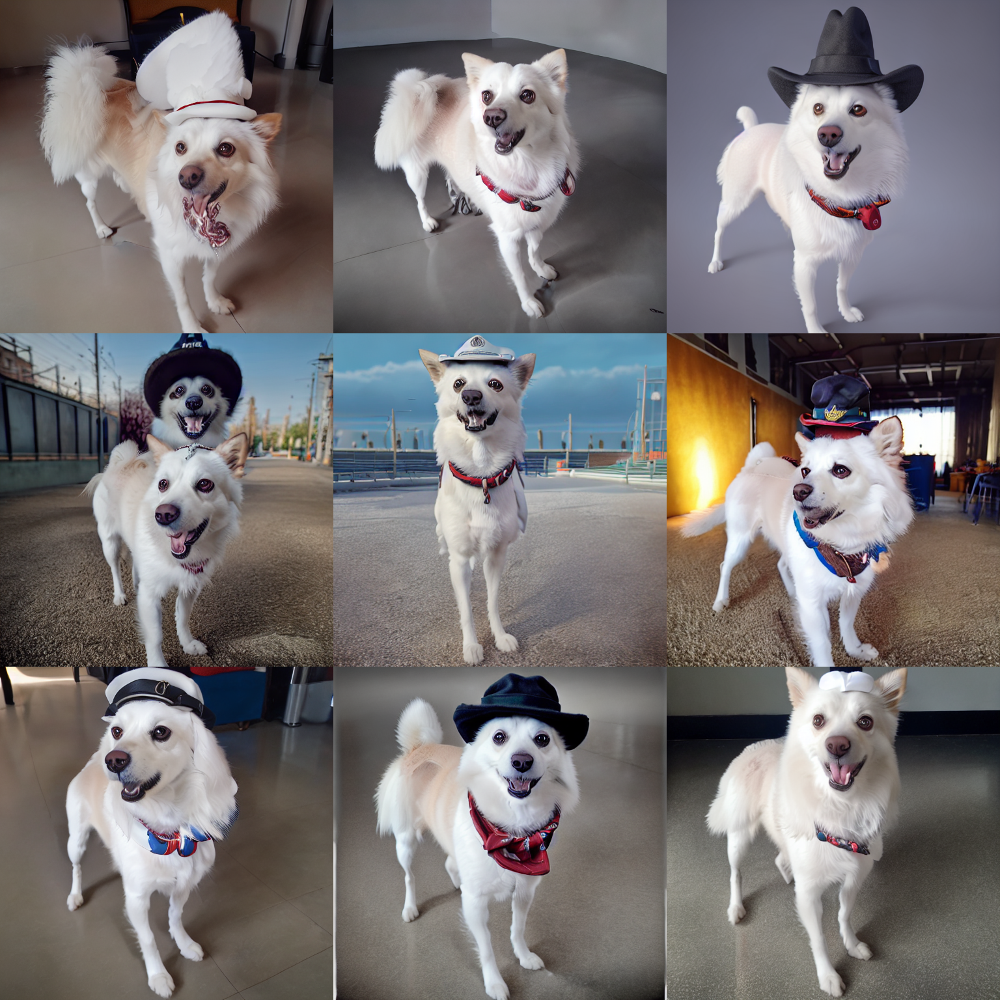

In [ ]:
#| code-fold: true
prompt = "portrait of a sks dog wearing a hat, realism, realistic, photorealism, f 3. 5, photography, octane render, trending on artstation, artstationhd, artstationhq, unreal engine, cinema 4 d, 8 k, detailed fur " 

num_samples = 3 
num_rows = 3 

# def dummy_checker(images, **kwargs): return images, False
# pipe.safety_checker = dummy_checker

all_images = [] 
for _ in range(num_rows):
    images = pipe([prompt] * num_samples, num_inference_steps=75, guidance_scale=7.5, seed = 'random').images
    all_images.extend(images)

grid = image_grid(all_images, num_samples, num_rows)
grid 

<figcaption align = "center">
        <h4>Fig 4: Portrait of a sks dog wearing a hat, realism, realistic, photorealism, f 3. 5, photography, octane render, trending on artstation, artstationhd, artstationhq, unreal engine, cinema 4 d, 8 k, detailed fur " 
</h4>
</figcaption>

  0%|          | 0/76 [00:00<?, ?it/s]

  0%|          | 0/76 [00:00<?, ?it/s]

  0%|          | 0/76 [00:00<?, ?it/s]

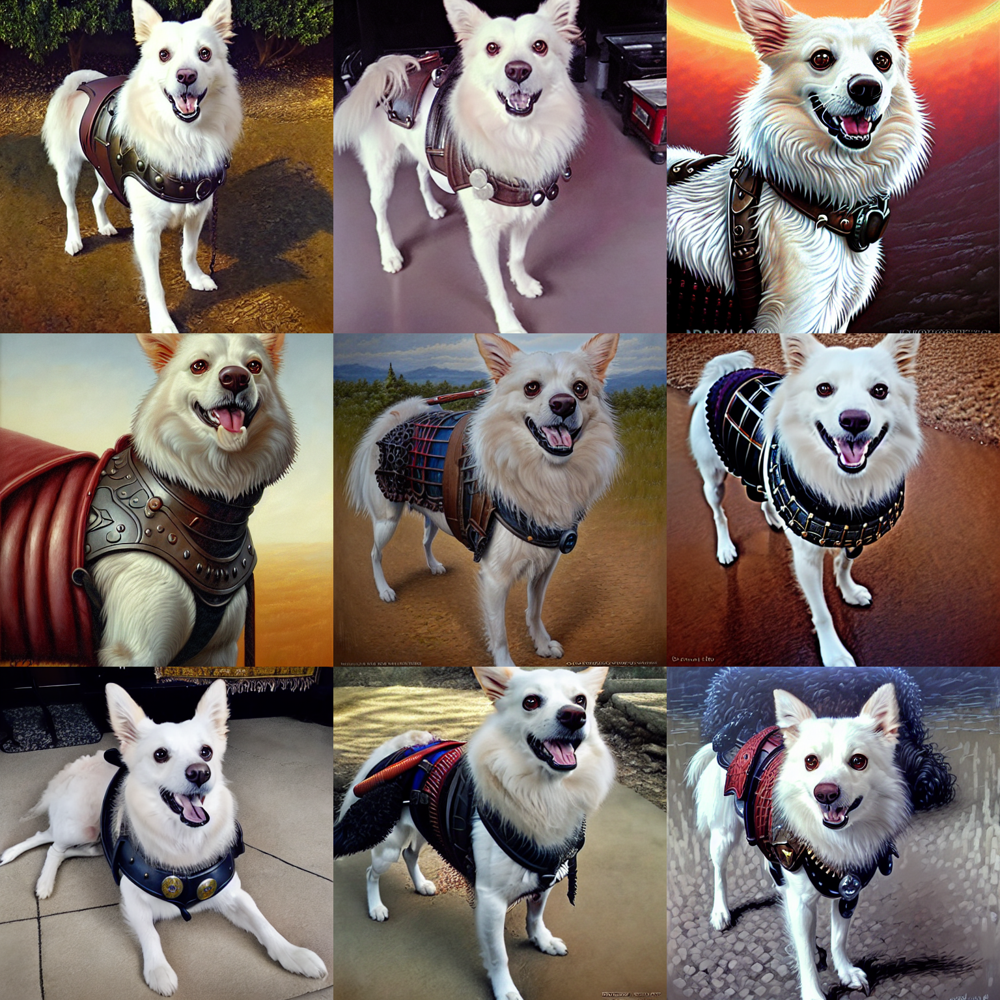

In [ ]:
#| code-fold: true
prompt = "sks dog as a realistic fantasy knight, closeup portrait art by donato giancola and greg rutkowski, digital art, trending on artstation, symmetry!! " 

num_samples = 3 
num_rows = 3 


all_images = [] 
for _ in range(num_rows):
    images = pipe([prompt] * num_samples, num_inference_steps=75, guidance_scale=7.5, seed = 'random').images
    all_images.extend(images)

grid = image_grid(all_images, num_samples, num_rows)
grid 

<figcaption align = "center">
        <h4>Fig 5: sks dog as a realistic fantasy knight, closeup portrait art by donato giancola and greg rutkowski, digital art, trending on artstation, symmetry!! 
</h4>
</figcaption>

  0%|          | 0/76 [00:00<?, ?it/s]

  0%|          | 0/76 [00:00<?, ?it/s]

  0%|          | 0/76 [00:00<?, ?it/s]

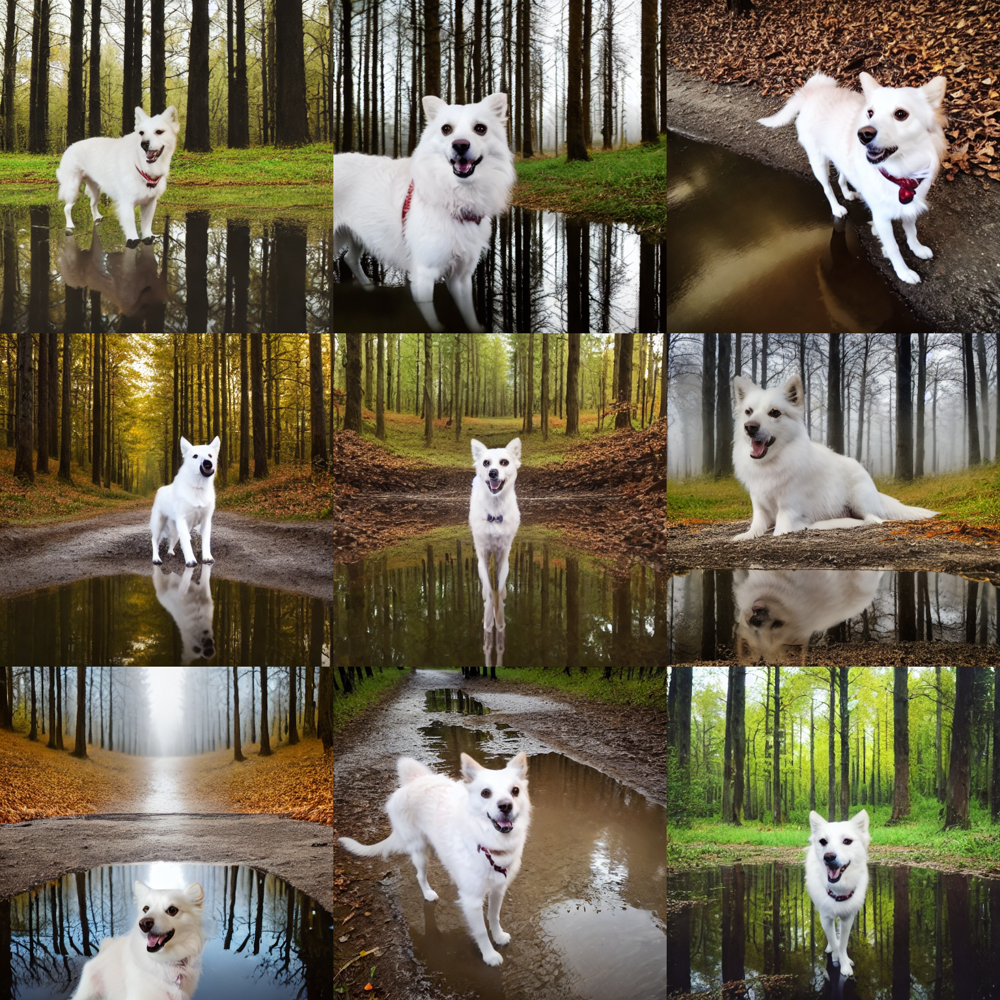

In [ ]:
#| code-fold: true
prompt = "white sks dog, with reflection in the puddle, foggy old forest, very detailed, 4 k, professional photography " 

num_samples = 3 
num_rows = 3 


all_images = [] 
for _ in range(num_rows):
    images = pipe([prompt] * num_samples, num_inference_steps=75, guidance_scale=7.5, seed = 'random').images
    all_images.extend(images)

grid = image_grid(all_images, num_samples, num_rows)
grid 

<figcaption align = "center">
        <h4>Fig 6 :  White sks dog, with reflection in the puddle, foggy old forest, very detailed, 4 k, professional photography 
</h4>
</figcaption>

  0%|          | 0/76 [00:00<?, ?it/s]

  0%|          | 0/76 [00:00<?, ?it/s]

  0%|          | 0/76 [00:00<?, ?it/s]

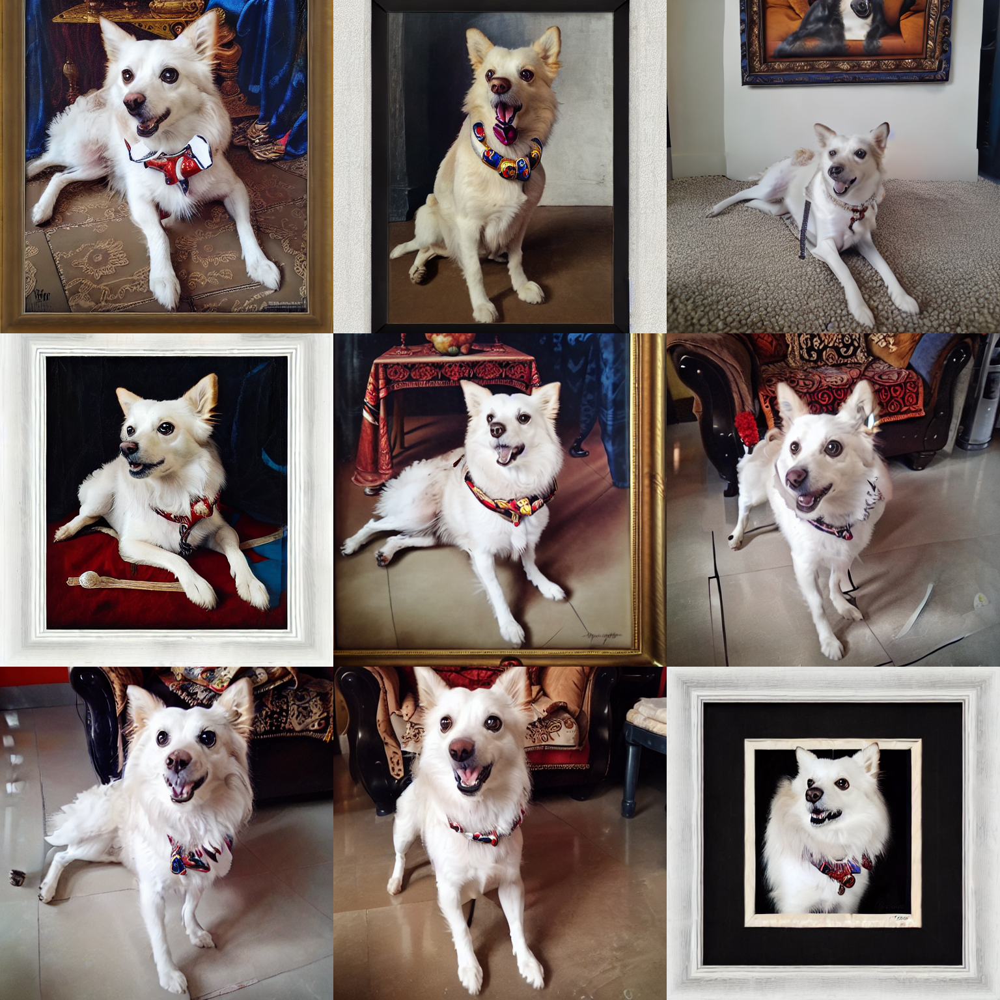

In [ ]:
#| code-fold: true
prompt = "framed renaissance portrait of a sks dog" 

num_samples = 3 
num_rows = 3 


all_images = [] 
for _ in range(num_rows):
    images = pipe([prompt] * num_samples, num_inference_steps=75, guidance_scale=7.5, seed = 'random').images
    all_images.extend(images)

grid = image_grid(all_images, num_samples, num_rows)
grid 

<figcaption align = "center">
        <h4>Fig 7: Framed renaissance portrait of a sks dog</h4>
</figcaption>

In the below results, the prompt is truncated since CLIP can only handle prompts with maximum of 77 tokens

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['shot, illustration, art by greg rutkowski beeple and alphonse mucha', 'shot, illustration, art by greg rutkowski beeple and alphonse mucha', 'shot, illustration, art by greg rutkowski beeple and alphonse mucha']


  0%|          | 0/76 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['shot, illustration, art by greg rutkowski beeple and alphonse mucha', 'shot, illustration, art by greg rutkowski beeple and alphonse mucha', 'shot, illustration, art by greg rutkowski beeple and alphonse mucha']


  0%|          | 0/76 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['shot, illustration, art by greg rutkowski beeple and alphonse mucha', 'shot, illustration, art by greg rutkowski beeple and alphonse mucha', 'shot, illustration, art by greg rutkowski beeple and alphonse mucha']


  0%|          | 0/76 [00:00<?, ?it/s]

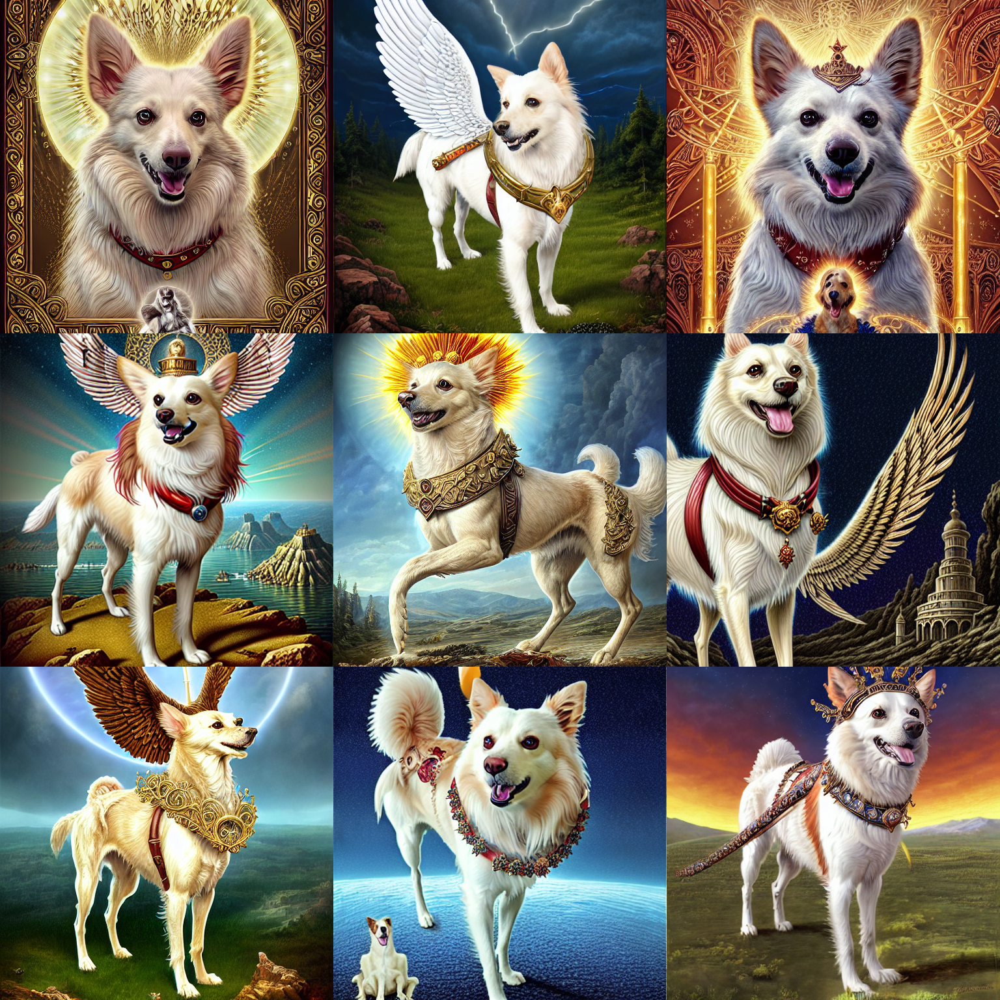

In [ ]:
#| code-fold: true
prompt = "a sks dog as god with a radiant halo, wings, detailed face, gorgeous, flowing hair, very muscular male body, partial anatomy, stormy and grand war scene, delicate and intricate borders for decoration, caesar victorious, proud Emperor, crepuscular ray, intricate, highly detailed, 8K, digital painting, fantasy, concept art, sharp focus, over-shoulder shot, illustration, art by greg rutkowski beeple and alphonse mucha"
num_samples = 3 
num_rows = 3 


all_images = [] 
for _ in range(num_rows):
    images = pipe([prompt] * num_samples, num_inference_steps=75, guidance_scale=7.5, seed = 'random').images
    all_images.extend(images)

grid = image_grid(all_images, num_samples, num_rows)
grid 

<figcaption align = "center">
        <h4>Fig 8: A sks dog as god with a radiant halo, wings, detailed face, gorgeous, flowing hair, very muscular male body, partial anatomy, stormy and grand war scene, delicate and intricate borders for decoration, caesar victorious, proud Emperor, crepuscular ray, intricate, highly detailed, 8K, digital painting, fantasy, concept art, sharp focus, over-shoulder shot, illustration, art by greg rutkowski beeple and alphonse mucha
</h4>
</figcaption>

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', art by greg rutkowski beeple and alphonse mucha', ', art by greg rutkowski beeple and alphonse mucha', ', art by greg rutkowski beeple and alphonse mucha']


  0%|          | 0/76 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', art by greg rutkowski beeple and alphonse mucha', ', art by greg rutkowski beeple and alphonse mucha', ', art by greg rutkowski beeple and alphonse mucha']


  0%|          | 0/76 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', art by greg rutkowski beeple and alphonse mucha', ', art by greg rutkowski beeple and alphonse mucha', ', art by greg rutkowski beeple and alphonse mucha']


  0%|          | 0/76 [00:00<?, ?it/s]

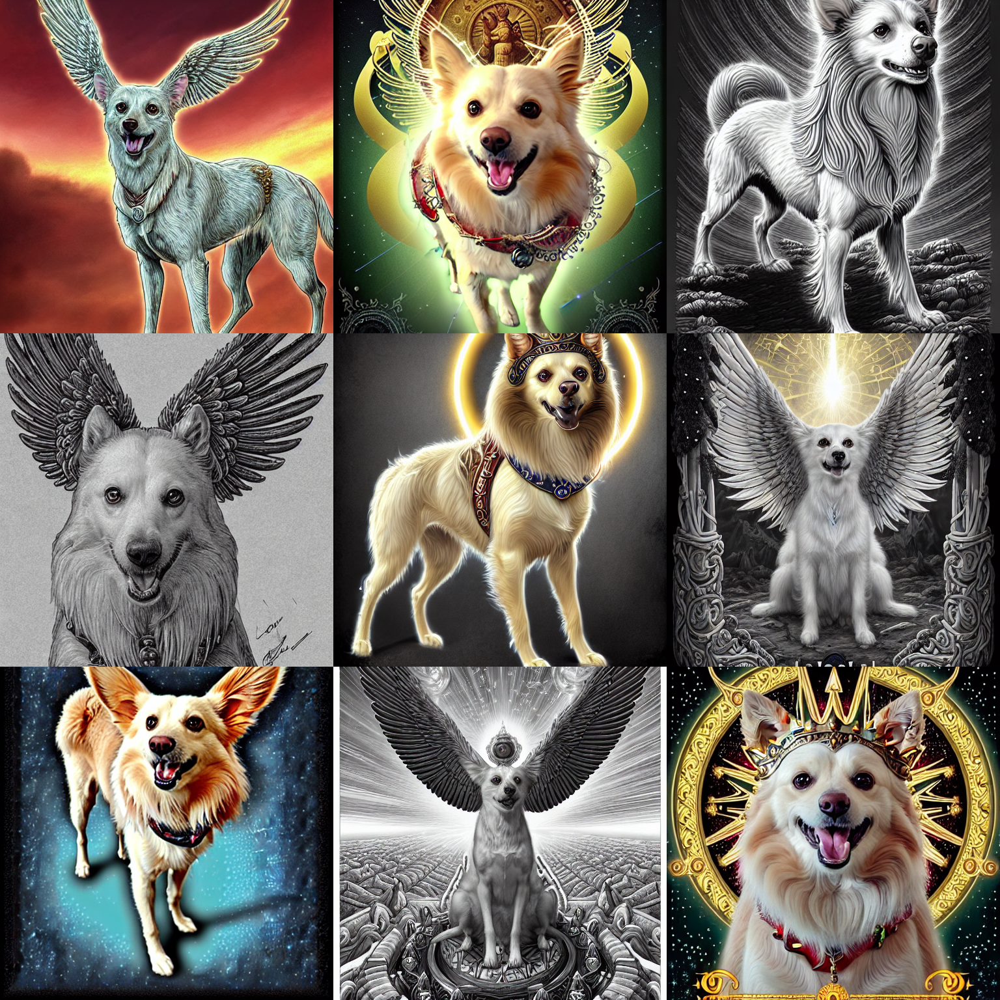

In [ ]:
#| code-fold: true
prompt = "a sks dog as god with a radiant halo, wings, detailed face, gorgeous, flowing hair, very muscular male body, stormy and grand war scene, delicate and intricate borders for decoration, caesar victorious, proud Emperor, crepuscular ray, intricate, highly detailed, 8K, digital painting, fantasy, concept art, sharp focus, over-shoulder shot, illustration, art by greg rutkowski beeple and alphonse mucha"
num_samples = 3 
num_rows = 3 


all_images = [] 
for _ in range(num_rows):
    images = pipe([prompt] * num_samples, num_inference_steps=75, guidance_scale=7.5, seed = 'random').images
    all_images.extend(images)

grid = image_grid(all_images, num_samples, num_rows)
grid 

<figcaption align = "center">
        <h4>Fig 9: A sks dog as god with a radiant halo, wings, detailed face, gorgeous, flowing hair, very muscular male body, stormy and grand war scene, delicate and intricate borders for decoration, caesar victorious, proud Emperor, crepuscular ray, intricate, highly detailed, 8K, digital painting, fantasy, concept art, sharp focus, over-shoulder shot, illustration, art by greg rutkowski beeple and alphonse mucha
</h4>
</figcaption>

# Pushing your model to hub

HuggingFace Hub is a platform with over 60K models, 6K datasets and 6K demo apps(spaces) all open source and publicly available. The best part is that sharing and using any public model on the Hub is completely free of cost. Let's next see how we can move our model from Google Drive to HuggingFace Hub. In order to push model to hub, make sure that you have used Access token with write permission while authenticating to HuggingFace

The ```get_full_repo_name``` returns the repository name for given model in user's namespace ({username/model_name}). 

In [7]:
from huggingface_hub import get_full_repo_name
model_name = "pintu_dreambooth"


In [8]:
hub_model = get_full_repo_name(model_name)
hub_model

'prajwal13/pintu_dreambooth'

In [10]:
output_dir = "/content/gdrive/My Drive/pintu_dreambooth"
images_folder = "/content/gdrive/My Drive/pintu"
torch_device = "cuda" if torch.cuda.is_available() else "cpu"

We can then use ```create_repo``` to create an empty directory in HuggingFace hub and push our model and the images used for training 
to the empty repo.

In [ ]:
from huggingface_hub import HfApi, create_repo

create_repo(hub_model)
api = HfApi()
api.upload_folder(folder_path=output_dir, path_in_repo="", repo_id=hub_model)

'https://huggingface.co/prajwal13/pintu_dreambooth/tree/main/'

In [ ]:
api.upload_folder(folder_path=images_folder, path_in_repo="concept_images",repo_id=hub_model)

'https://huggingface.co/prajwal13/pintu_dreambooth/tree/main/concept_images'

The last thing to do is create a model card so that our model can easily be found on the Hub. We will also add the images used to train in the model card

In [ ]:
#| output: false
from huggingface_hub import ModelCard
import os

images_upload = os.listdir(images_folder)
image_string = ""

for i, image in enumerate(images_upload):
    image_string = f'''{image_string}![sks {i}](https://huggingface.co/{hub_model}/resolve/main/concept_images/{image})'''

image_string

In [ ]:
content = f"""
---
license: mit
tags:
- pytorch
- diffusers
- dreambooth
---

# Model Card for Dreambooth model trained on My pet Pintu's images

This model is a diffusion model for unconditional image generation of my cute pet dog Pintu trained using Dreambooth concept. The token to use is sks .

## Usage

from diffusers import StableDiffusionPipeline
pipeline = StableDiffusionPipeline.from_pretrained({hub_model})
image = pipeline('a photo of sks dog').images[0]
image

These are the images on which the dreambooth model is trained on

{image_string}

"""

In [ ]:
card = ModelCard(content)
card.push_to_hub(hub_model)

'https://huggingface.co/prajwal13/pintu_dreambooth/blob/main/README.md'

Now we can directly load the model from HuggingFace Hub by passing the repo id to the pipeline

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

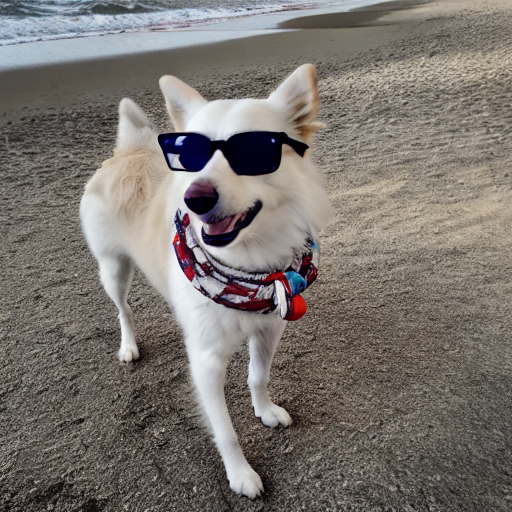

In [22]:
#| fig-align: center
from diffusers import StableDiffusionPipeline

pipeline = StableDiffusionPipeline.from_pretrained(hub_model).to(torch_device)
image = pipeline("a photo of sks dog wearing glasses, and standing near beach").images[0]
image

# Conclusion

In this post, we learnt about Dreambooth and how we can personalize the Stable Diffusion model. We also learnt how to push our model to HuggingFace hub.

I hope you enjoyed reading it. If there is any feedback, feel free to reach out on [LinkedIn](https://www.linkedin.com/in/prajwal-s-1416061b3/) or on [mail](mailto:prajwalsuresh13@gmail.com)

# References

- [FastAI course](https://www.fast.ai/posts/part2-2022-preview.html)
- [Dreambooth paper](https://dreambooth.github.io/)
- [HuggingFace Dreambooth notebook](https://github.com/huggingface/notebooks/blob/main/diffusers/sd_dreambooth_training.ipynb)